## Paw wavelet clusters

In [20]:
prefix = '/home/ines/repositories/'
prefix = '/Users/ineslaranjeira/Documents/Repositories/'

In [ ]:
import os
import numpy as np
from one.api import ONE
import pickle
import matplotlib.pyplot as plt
import pandas as pd
import brainbox.behavior.wheel as wh
from scipy.stats import zscore
from kneed import KneeLocator
from scipy.spatial.distance import cdist
from sklearn.cluster import KMeans
from brainbox.io.one import SessionLoader
import scipy.interpolate as interpolate
from joblib import Parallel, delayed
from scipy.fftpack import fft, ifft, fftshift
from scipy.signal import butter, filtfilt
from sklearn.preprocessing import StandardScaler, Normalizer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap
import seaborn as sns

# one = ONE(base_url='https://alyx.internationalbrainlab.org')
one = ONE(mode='remote')
# Get my functions
functions_path =  prefix + 'representation_learning_variability/Models/Sub-trial//4_analyses/5_clustering_analyses//'
os.chdir(functions_path)
from clustering_functions import GMM_neg_log_likelihood

In [22]:
import ibllib
print(ibllib.__file__)

/Users/ineslaranjeira/Documents/Repositories/ibllib/ibllib/__init__.py


# Design Matrix V6 14 Jul 2025

- Same as V5 but with paws and other minor changes

### Get sessions which pass QC

In [23]:
# Load preprocessed data
results_path = prefix + 'representation_learning_variability/paper-individuality/'
filename = str(results_path + '1_bwm_qc_07-10-2025')
bwm_query = pickle.load(open(filename, "rb"))

FileNotFoundError: [Errno 2] No such file or directory: '/Users/ineslaranjeira/Documents/Repositories/representation_learning_variability/paper-individuality/1_bwm_qc_07-10-2025'

In [ ]:
# Load preprocessed data
results_path = prefix + 'representation_learning_variability/Video and wheel/Video QC/'
# filename = str(results_path + '1_bwm_qc_07-10-2025')
filename = str(results_path + 'final_lp_qc07-10-2025')

bwm_query = pickle.load(open(filename, "rb"))

### Parameters

In [ ]:
bin_size = 0.1  # seconds
bin_size = 0.017  # np.round(1/60, 3)  # No binning, number indicates sampling rate
video_type = 'left'    
first_90 = False
lp = True

# Wavelet decomposition
f = np.array([.25, .5, 1, 2, 4, 8, 16])
f = np.array([.5, 1, 2, 4, 8])

omega0 = 5

sessions =  bwm_query['eid'].unique()

In [ ]:
def get_feature_event_times(dlc, dlc_t, features):
    """
    Detect events from the dlc traces. Based on the standard deviation between frames
    :param dlc: dlc pqt table
    :param dlc_t: dlc times
    :param features: features to consider
    :return:
    """

    for i, feat in enumerate(features):
        f = dlc[feat]
        threshold = np.nanstd(np.diff(f)) / 4
        if i == 0:
            events = np.where(np.abs(np.diff(f)) > threshold)[0]
        else:
            events = np.r_[events, np.where(np.abs(np.diff(f)) > threshold)[0]]

    return dlc_t[np.unique(events)]


def merge_licks(poses, features, common_fs):
    
    # Define total duration (max of both videos)
    duration_sec = max(list(poses['leftCamera']['times'])[-1], list(poses['rightCamera']['times'])[-1])  # in seconds

    # Set common sampling rate (high rather than low)
    t_common = np.arange(0, duration_sec, 1/common_fs)  # uniform timestamps
    
    lick_trace_left = np.zeros_like(t_common, dtype=int)
    lick_trace_right = np.zeros_like(t_common, dtype=int)

    left_lick_times = get_feature_event_times(poses['leftCamera'], poses['leftCamera']['times'], features)
    right_lick_times = get_feature_event_times(poses['rightCamera'], poses['rightCamera']['times'], features)

    # Round licks to nearest timestamp in t_common
    left_indices = np.searchsorted(t_common, left_lick_times)
    right_indices = np.searchsorted(t_common, right_lick_times)

    # Set licks to 1
    lick_trace_left[left_indices[left_indices < len(t_common)]] = 1
    lick_trace_right[right_indices[right_indices < len(t_common)]] = 1

    combined_licks = np.maximum(lick_trace_left, lick_trace_right)
    
    return t_common, combined_licks 


def lowpass_filter(data, cutoff, fs, order=4):
    nyq = 0.5 * fs  # Nyquist frequency
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='lowpass', analog=False)
    return filtfilt(b, a, data)


def interpolate_nans(pose, camera):

    # threshold (in seconds) above which we will not interpolate nans,
    # but keep them (for long stretches interpolation may not be appropriate)
    nan_thresh = .1
    SAMPLING = {'left': 60,
                'right': 150,
                'body': 30}
    fr = SAMPLING[camera]

    # don't interpolate long strings of nans
    t = np.diff(1 * np.isnan(np.array(pose)))
    begs = np.where(t == 1)[0]
    ends = np.where(t == -1)[0]
    if np.isnan(np.array(pose)[0]):
        begs = begs[:-1]
        ends = ends[1:]
    if begs.shape[0] > ends.shape[0]:
        begs = begs[:ends.shape[0]]

    interp_pose = pose.copy()
    interp_pose = np.array(interp_pose.interpolate(method='cubic'))

    # If needed, low_pass_filter:
    if camera == 'right':
        # Sometimes array starts with NaNs, should ignore those
        not_nan = interp_pose[np.where(~np.isnan(interp_pose))]
        low_pass = lowpass_filter(not_nan, cutoff=30, fs=fr, order=4)

        smoothed = interp_pose.copy()
        smoothed[np.where(~np.isnan(interp_pose))] = low_pass
    else:
        smoothed = interp_pose.copy()

    # Restore long NaNs
    for b, e in zip(begs, ends):
        if (e - b) > (fr * nan_thresh):
            smoothed[(b + 1):(e + 1)] = np.nan  # offset by 1 due to earlier diff
        
    return smoothed


# This function uses get_XYs, not smoothing, is closer to brainbox function: https://github.com/int-brain-lab/ibllib/blob/78e82df8a51de0be880ee4076d2bb093bbc1d2c1/brainbox/behavior/dlc.py#L63
def get_speed(poses, times, camera, split, feature):
    """
    FIXME Document and add unit test!

    :param dlc: dlc pqt table
    :param dlc_t: dlc time points
    :param camera: camera type e.g 'left', 'right', 'body'
    :param feature: dlc feature to compute speed over
    :return:
    """
    SAMPLING = {'left': 60,
                'right': 150,
                'body': 30}
    RESOLUTION = {'left': 2,
                  'right': 1,
                  'body': 1}

    speeds = {}
    interpolated_x = interpolate_nans(poses[f'{feature}_x'], camera)
    interpolated_y = interpolate_nans(poses[f'{feature}_y'], camera)
    # interpolated_x = poses[f'{feature}_x']
    # interpolated_y = poses[f'{feature}_y']
    x = interpolated_x / RESOLUTION[camera]
    y = interpolated_y / RESOLUTION[camera]
    # if camera == 'right':
    #     fs = SAMPLING[camera]
    #     x = lowpass_filter(x, cutoff=30, fs=fs, order=4)
    #     y = lowpass_filter(y, cutoff=30, fs=fs, order=4)

    # get speed in px/sec [half res]
    # s = ((np.diff(x) ** 2 + np.diff(y) ** 2) ** .5) * SAMPLING[camera]
    dt = np.diff(times)
    tv = times[:-1] + dt / 2


    # Calculate velocity for x and y separately if split is true
    if split == True:
        s_x = np.diff(x) * SAMPLING[camera]
        s_y = np.diff(y) * SAMPLING[camera]
        speeds[camera] = [times, s_x, s_y]
        # interpolate over original time scale
        if tv.size > 1:
            ifcn_x = interpolate.interp1d(tv, s_x, fill_value="extrapolate")
            ifcn_y = interpolate.interp1d(tv, s_y, fill_value="extrapolate")
            speeds[camera] = [times, ifcn_x(times), ifcn_y(times)]
    else:
        # Speed vector is given by the Pitagorean theorem
        s = ((np.diff(x)**2 + np.diff(y)**2)**.5) * SAMPLING[camera]
        speeds[camera] = [times, s]
        # interpolate over original time scale
        if tv.size > 1:
            ifcn = interpolate.interp1d(tv, s, fill_value="extrapolate")
            speeds[camera] = [times, ifcn(times)]

    return speeds        

# def get_lick_times(poses, features, combine=False, video_type='left'):
    
#     if combine:    
#         # combine licking events from left and right cam
#         lick_times = []
#         for video_type in ['right','left']:
#             camera_name = str(video_type+'Camera')
#             camera_licks = get_feature_event_times(poses[camera_name], 
#                                                  poses[camera_name]['times'], features)        
#             lick_times.append(camera_licks)
        
#         lick_times = np.array(sorted(np.concatenate(lick_times)))
        
#     else:
#         lick_times = get_feature_event_times(poses[video_type], 
#                                              poses[video_type]['times'], features)     
        
#     return lick_times


def resample_common_time(reference_time, timestamps, data, kind, fill_gaps=None):
    
    # # t = np.arange(t_init, t_end, 1 / freq)  # Evenly resample at frequency
    # if reference_time[-1] > timestamps[-1]:
    #     reference_time = reference_time[:-1]  # Occasionally due to precision errors the last sample may be outside of range.
    yinterp = interpolate.interp1d(timestamps, data, kind=kind, fill_value='extrapolate')(reference_time)
    
    if fill_gaps:
        #  Find large gaps and forward fill @fixme This is inefficient
        gaps, = np.where(np.diff(timestamps) >= fill_gaps)

        for i in gaps:
            yinterp[(reference_time >= timestamps[i]) & (reference_time < timestamps[i + 1])] = data[i]
            
    return yinterp, reference_time


# def resample_common_time(reference_time, timestamps, data, kind, fill_gaps=None):
#     # Function inspired on wh.interpolate from here: https://github.com/int-brain-lab/ibllib/blob/master/brainbox/behavior/wheel.py#L28 
#     # t = np.arange(t_init, t_end, 1 / freq)  # Evenly resample at frequency
#     if reference_time[-1] > timestamps[-1]:
#         reference_time = reference_time[:-1]  # Occasionally due to precision errors the last sample may be outside of range.
#     yinterp = interpolate.interp1d(timestamps, data, kind=kind, fill_value='extrapolate')(reference_time)
    
#     if fill_gaps:
#         #  Find large gaps and forward fill @fixme This is inefficient
#         gaps, = np.where(np.diff(timestamps) >= fill_gaps)

#         for i in gaps:
#             yinterp[(reference_time >= timestamps[i]) & (reference_time < timestamps[i + 1])] = data[i]
            
#     return yinterp, reference_time


def morlet_conj_ft(omega_vals, omega0):
    """
    Computes the conjugate Fourier transform of the Morlet wavelet.
    
    Parameters:
    - w: Angular frequency values (array or scalar)
    - omega0: Dimensionless Morlet wavelet parameter
    
    Returns:
    - out: Conjugate Fourier transform of the Morlet wavelet
    """
    
    return np.pi**(-1/4) * np.exp(-0.5 * (omega_vals - omega0)**2)


def fast_wavelet_morlet_convolution_parallel(x, f, omega0, dt):
    """
    Fast Morlet wavelet transform using parallel computation.

    Args:
        x (array): 1D array of projection values to transform.
        f (array): Center frequencies of the wavelet frequency channels (Hz).
        omega0 (float): Dimensionless Morlet wavelet parameter.
        dt (float): Sampling time (seconds).

    Returns:
        amp (array): Wavelet amplitudes.
        W (array): Wavelet coefficients (complex-valued, optional).
    """
    N = len(x)
    L = len(f)
    amp = np.zeros((L, N))
    Q = np.zeros((L, N))

    # Ensure N is even
    if N % 2 == 1:
        x = np.append(x, 0)
        N += 1
        test = True
    else:
        test = False

    # Add zero padding to x
    # Zero padding serves to compensate for the fact that the kernel does not have the same size as 
    # 
    x = np.concatenate((np.zeros(N // 2), x, np.zeros(N // 2)))
    M = N
    N = len(x)

    # Compute scales
    scales = (omega0 + np.sqrt(2 + omega0**2)) / (4 * np.pi * f)
    # angular frequencies to compute FT for (depends on sampling frequency); is as long as N 
    omega_vals = 2 * np.pi * np.arange(-N // 2, N // 2) / (N * dt)  

    # Fourier transform of x; shift folds it around zero so that it is more interpretable (frequencies at the right of nyquist become negative)
    x_hat = fftshift(fft(x))

    # Index for truncation to recover the actual x without padding
    if test:
        idx = np.arange(M // 2, M // 2 + M - 1)
    else:
        idx = np.arange(M // 2, M // 2 + M)

    # Function for parallel processing
    def process_frequency(i):
        # Take the Morlet conjugate of the Fourier transform
        m = morlet_conj_ft(-omega_vals * scales[i], omega0)
        # Convolution on the Fourier domain (as opposed to time domain in DWT)
        conv = m * x_hat
        # Inverse Fourier transform (normalized?)
        # q are the wavelet coefficients; normalized to ensure the energy of the wavelet is preserved across different scales
        q = ifft(conv) * np.sqrt(scales[i])
        # Recover q without padding
        q = q[idx]
        amp_row = np.abs(q) * np.pi**-0.25 * np.exp(0.25 * (omega0 - np.sqrt(omega0**2 + 2))**2) / np.sqrt(2 * scales[i])
        return amp_row, q

    # Parallel processing
    results = Parallel(n_jobs=-1)(delayed(process_frequency)(i) for i in range(L))

    for i, (amp_row, q) in enumerate(results):
        amp[i, :] = amp_row
        Q[i, :] = q

    return amp, Q, x_hat


## With session loader

## Check sessions missing

In [ ]:
# Loop through animals
sessions =  bwm_query['eid'].unique()
data_path =prefix + 'representation_learning_variability/DATA/Sub-trial/Design matrix/v6_21Jul2025/' + str(bin_size) + '/'
os.chdir(data_path)
files = os.listdir()
sessions_to_process = []

for s, sess in enumerate(sessions):
    file_path = one.eid2path(sess)
    if prefix == '/home/ines/repositories/':
        mouse_name = file_path.parts[8]
    else:
        mouse_name = file_path.parts[7]
    filename = "design_matrix_" + str(sess) + '_'  + mouse_name
    if filename not in files:
        sessions_to_process.append((sess))

len(sessions_to_process)
        

118

In [ ]:
session = sessions_to_process[0]

file_path = one.eid2path(session)
if prefix == '/home/ines/repositories/':
    mouse_name = file_path.parts[8]
else:
    mouse_name = file_path.parts[7]

""" LOAD VARIABLES """
sl = SessionLoader(eid=session, one=one)
sl.load_pose(views=['left', 'right'], tracker='lightningPose')
sl.load_session_data(trials=True, wheel=True, motion_energy=True)

# Check if all data is available
if np.sum(sl.data_info['is_loaded']) >= 4:

    poses = sl.pose

    # Wheel
    wheel = sl.wheel
    wheel_time = np.array(wheel['times'])
    wheel_vel = np.array(wheel['velocity'])
    
    # Left paw
    l_paw_speeds = get_speed(poses['leftCamera'], poses['leftCamera']['times'], 'left', True, feature='paw_r')
    l_paw_time = np.array(l_paw_speeds['left'][0])

    # Right paw
    r_paw_speeds = get_speed(poses['rightCamera'], poses['rightCamera']['times'], 'right', True, feature='paw_r')
    r_paw_time = np.array(r_paw_speeds['right'][0])

    # Left paw
    l_paw_time = np.array(l_paw_speeds['left'][0])
    l_paw_x = interpolate_nans(poses['leftCamera']['paw_r_x'], 'left')
    l_paw_y = interpolate_nans(poses['leftCamera']['paw_r_y'], 'left')

    # Right paw
    r_paw_time = np.array(r_paw_speeds['right'][0])
    r_paw_x = interpolate_nans(poses['rightCamera']['paw_r_x'], 'right')
    r_paw_y = interpolate_nans(poses['rightCamera']['paw_r_y'], 'right')
    
    """ COMMON TIMESTAMPS AND RESAMPLING"""
    # Use reference time, truncate and resample
    onset = np.max([np.min(poses['leftCamera']['times']), np.min(poses['rightCamera']['times']), np.min(wheel['times'])])
    offset = np.min([np.max(poses['leftCamera']['times']), np.max(poses['rightCamera']['times']), np.max(wheel['times'])])
    
    common_fs = 60
    # Set common sampling rate (high rather than low)
    reference_time = np.arange(onset, offset, 1/common_fs)  # uniform timestamps

    wheel_vel = wheel_vel[np.where((wheel_time >= onset) & (wheel_time < offset))]
    wheel_time = wheel_time[np.where((wheel_time >= onset) & (wheel_time < offset))]
    donwsampled_wheel, corrected_wheel_t = resample_common_time(reference_time, wheel_time, wheel_vel, kind='linear', fill_gaps=None)
    
    l_paw_x = l_paw_x[np.where((l_paw_time >= onset) & (l_paw_time < offset))]
    l_paw_y = l_paw_y[np.where((l_paw_time >= onset) & (l_paw_time < offset))]
    l_paw_time = l_paw_time[np.where((l_paw_time >= onset) & (l_paw_time < offset))]
    donwsampled_l_paw_x, corrected_l_paw_x_t = resample_common_time(reference_time, l_paw_time, l_paw_x, kind='linear', fill_gaps=None)
    donwsampled_l_paw_y, corrected_l_paw_y_t = resample_common_time(reference_time, l_paw_time, l_paw_y, kind='linear', fill_gaps=None)

    r_paw_x = r_paw_x[np.where((r_paw_time >= onset) & (r_paw_time < offset))]
    r_paw_y = r_paw_y[np.where((r_paw_time >= onset) & (r_paw_time < offset))]
    r_paw_time = r_paw_time[np.where((r_paw_time >= onset) & (r_paw_time < offset))]
    donwsampled_r_paw_x, corrected_r_paw_x_t = resample_common_time(reference_time, r_paw_time, r_paw_x, kind='linear', fill_gaps=None)
    donwsampled_r_paw_y, corrected_r_paw_y_t = resample_common_time(reference_time, r_paw_time, r_paw_y, kind='linear', fill_gaps=None)

    # Check integrity of data
    assert (corrected_wheel_t == corrected_l_paw_x_t).all(), print('Assertion error')
    assert (corrected_l_paw_x_t == corrected_r_paw_x_t).all(), print('Assertion error')

    """ GROUP DATA INTO DESIGN MATRIX """
    design_matrix = pd.DataFrame(columns=['Bin', 'avg_wheel_vel',
                                            'l_paw_x', 'l_paw_y', 'r_paw_x', 'r_paw_y']) #'avg_wheel_vel',
    design_matrix['Bin'] = corrected_l_paw_x_t.copy()
    design_matrix['avg_wheel_vel'] = donwsampled_wheel.copy()
    design_matrix['l_paw_x'] = donwsampled_l_paw_x.copy()
    design_matrix['l_paw_y'] = donwsampled_l_paw_y.copy()
    design_matrix['r_paw_x'] = donwsampled_r_paw_x.copy()
    design_matrix['r_paw_y'] = donwsampled_r_paw_y.copy()

    for v, var in enumerate(['l_paw_x', 'l_paw_y', 'r_paw_x', 'r_paw_y']):
        time = np.array(design_matrix['Bin'])
        paw = np.array(design_matrix[var])

        # Wavelet decomposition of left paw
        not_nan = np.where(~np.isnan(paw))

        dt = np.round(np.mean(np.diff(time[not_nan])), 3)
        amp, Q, x_hat = fast_wavelet_morlet_convolution_parallel(paw[not_nan], f, omega0, dt)

        # Wavelet transforms
        for i, frequency in enumerate(f):
            # Create new column with frequency
            design_matrix[str(frequency)+'_'+var] = design_matrix['Bin'] * np.nan
            design_matrix[str(frequency)+'_'+var][not_nan] = amp[i, :]
else:
    print('Data missing for session '+session)  


/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/one/util.py:428: ALFWarning: Multiple revisions: "2025-05-31", ""
  warnings.warn(f'Multiple revisions: {rev_list}', alferr.ALFWarning)


2025-08-21 15:33:35 INFO     one.py:1288 Loading trials data


/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/one/util.py:428: ALFWarning: Multiple revisions: "", "2025-03-03"
  warnings.warn(f'Multiple revisions: {rev_list}', alferr.ALFWarning)


2025-08-21 15:33:36 INFO     one.py:1288 Loading wheel data
2025-08-21 15:33:37 INFO     one.py:1288 Loading motion_energy data


/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/one/util.py:428: ALFWarning: Multiple revisions: "", "2025-05-31"
  warnings.warn(f'Multiple revisions: {rev_list}', alferr.ALFWarning)
/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/one/util.py:428: ALFWarning: Multiple revisions: "", "2025-06-01"
  warnings.warn(f'Multiple revisions: {rev_list}', alferr.ALFWarning)


2025-08-21 15:33:37 INFO     one.py:1288 Loading pupil data
2025-08-21 15:33:37 WARNING  one.py:1292 Could not load pupil data.


/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/one/util.py:428: ALFWarning: Multiple revisions: "2025-06-20", ""
  warnings.warn(f'Multiple revisions: {rev_list}', alferr.ALFWarning)
/var/folders/nt/d2j3zp9d1xzb8wgfrw81j0c40000gn/T/ipykernel_31192/939970600.py:290: ComplexWarning: Casting complex values to real discards the imaginary part
  Q[i, :] = q
/var/folders/nt/d2j3zp9d1xzb8wgfrw81j0c40000gn/T/ipykernel_31192/3428052227.py:95: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = v

## Plot data

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
/var/folders/nt/d2j3zp9d1xzb8wgfrw81j0c40000gn/T/ipykernel_30388/3433569024.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


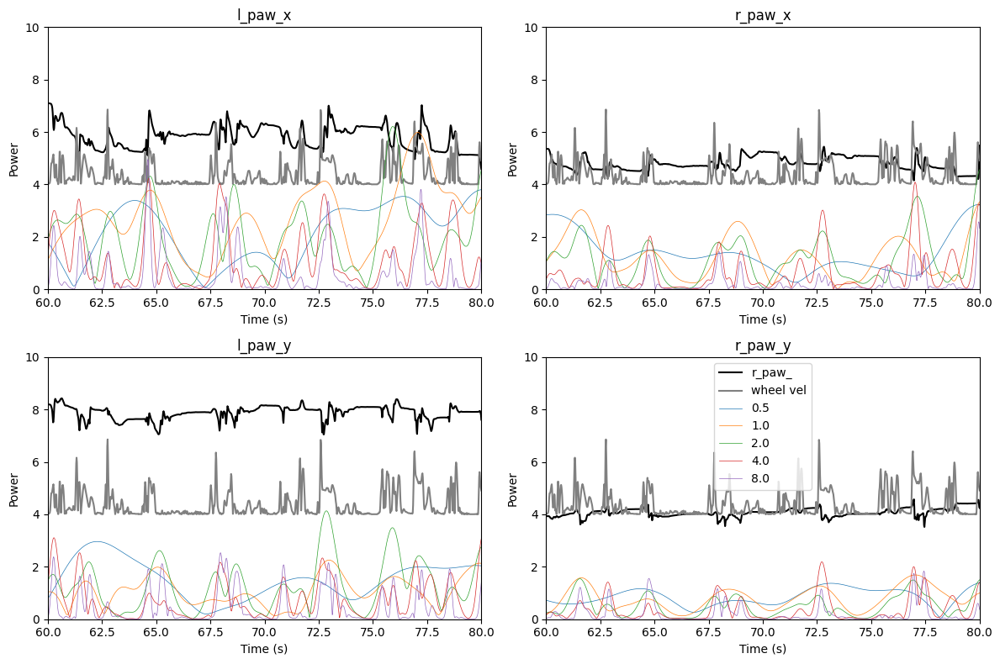

In [ ]:
init = 60
fig, ax = plt.subplots(figsize=(12, 8), nrows=2, ncols=2)
for v, var in enumerate(['l_paw_', 'r_paw_']):
    for c, coor in enumerate(['x', 'y']):
        ax[c, v].plot(design_matrix['Bin'], design_matrix[var+coor]/80, label=var, color='k')
        ax[c, v].plot(design_matrix['Bin'], np.abs(design_matrix['avg_wheel_vel'])+4, label='wheel vel', color='grey')

        # Wavelet transforms
        for i, frequency in enumerate(f):
            ax[c, v].plot(design_matrix['Bin'], design_matrix[str(frequency)+'_'+var+coor], label=str(frequency), linewidth=.5)
            ax[c, v].set_xlim([init, init+20])
            ax[c, v].set_ylim([0, 10])
            ax[c, v].set_ylabel('Power')
            ax[c, v].set_xlabel('Time (s)')
        ax[c, v].set_title(var+coor)
    ax[1, 1].legend()
    plt.tight_layout()

## Wavelet clustering

In [147]:
data = design_matrix.copy()
data = np.array(data.drop(columns=['Bin', 'avg_wheel_vel', 'l_paw_x', 'l_paw_y', 'r_paw_x', 'r_paw_y']).dropna()) 
X_centered = data - np.mean(data, axis=0)


### PCA

In [151]:
n_components = 6
# Step 1: Reduce dimensions with PCA
pca = PCA(n_components)  # Reduce to 50 dimensions
X_pca = pca.fit_transform(zscore(data, axis=1))
X_pca = pca.fit_transform(X_centered)

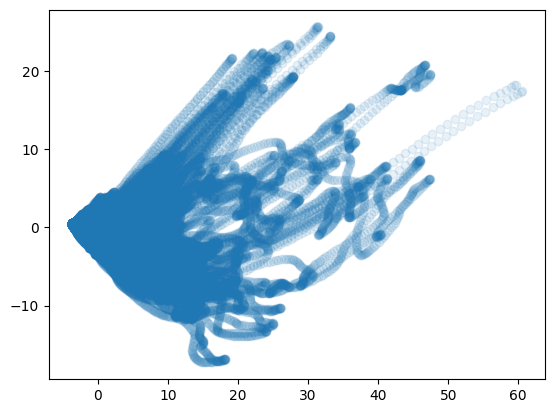

In [152]:
plt.scatter(X_pca[:, 0], X_pca[:, 1], alpha=.1)

In [153]:
import plotly.express as px

components = X_pca[:, :3]
labels = {
    str(i): f"PC {i+1} ({var:.1f}%)"
    for i, var in enumerate(pca.explained_variance_ratio_ * 100)
}

fig = px.scatter_matrix(
    components
)
fig.update_traces(diagonal_visible=False)
fig.show()

(0.0, 1.0)

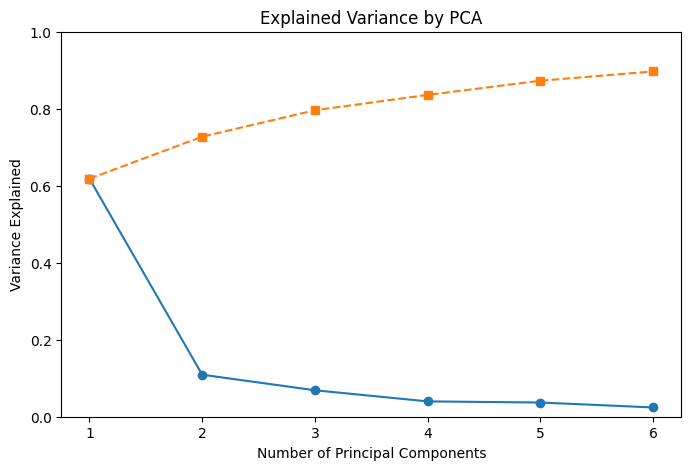

In [154]:
# Explained variance ratio
explained_variance_ratio = pca.explained_variance_ratio_
cumulative_variance = np.cumsum(explained_variance_ratio)

# Plot explained variance
plt.figure(figsize=(8, 5))
plt.plot(range(1, n_components+1), explained_variance_ratio, marker='o', label='Individual')
plt.plot(range(1, n_components+1), cumulative_variance, marker='s', label='Cumulative', linestyle='--')
plt.xlabel("Number of Principal Components")
plt.ylabel("Variance Explained")
plt.title("Explained Variance by PCA")
plt.ylim([0, 1])

### UMAP

In [145]:
np.shape(data)

(316175, 20)

In [146]:
reducer = umap.UMAP(random_state= 42, n_components=2)
embedding = reducer.fit_transform(X_pca)
embedding.shape

/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/umap/umap_.py:1945: UserWarning:

n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.



KeyboardInterrupt: 

## t-SNE

In [ ]:
np.shape(X_pca)

(316175, 6)

In [156]:
X_embedded = TSNE(n_components=2, learning_rate='auto',
                init='random', perplexity=32).fit_transform(X_pca)

KeyboardInterrupt: 

In [ ]:
plt.figure(figsize=(6, 4))
plt.rcParams.update({'font.size': 16})

scatter = plt.scatter(
    embedding[:, 0],
    embedding[:, 1],
    alpha=0.5,
    c='grey'  # Choose a colormap
)   
plt.legend(bbox_to_anchor=(1.1, 1.05))
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")

# K selection

In [ ]:
use_data = X_pca.copy()

repeats = 1
components = np.array([1, 2, 3, 4, 5, 6, 8, 10, 15, 20])
components = np.array([1, 5, 10, 15, 20])
LLs = np.zeros((repeats, len(components))) * np.nan
for r in range(repeats):    
    # Compute log likelihood of a GMM model with different components
    LLs[r, :] = GMM_neg_log_likelihood(use_data.copy(), components)
kneedle = KneeLocator(components[1:], np.nanmean(LLs, axis=0)[1:], curve="convex", direction="decreasing")
kneedle = KneeLocator(components, np.nanmean(LLs, axis=0), curve="convex", direction="decreasing")
optimal_k = kneedle.knee

KeyboardInterrupt: 

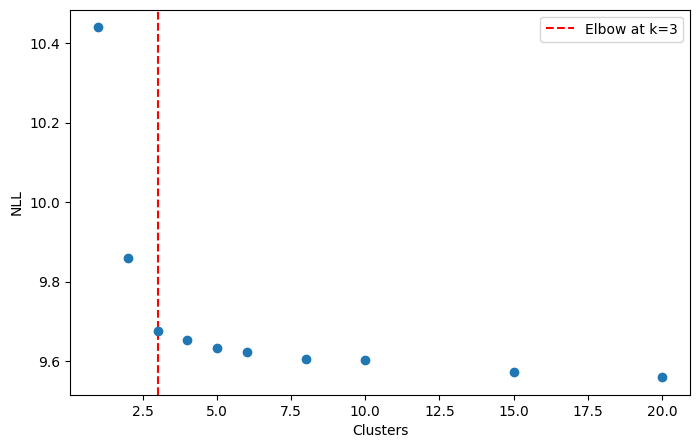

In [47]:
# Plot
fig, ax = plt.subplots(figsize=(8, 5))
# plt.plot(components[1:], LLs[0][1:], 'bo-', label="Model Fit")
plt.errorbar(components, np.nanmean(LLs, axis=0), np.nanstd(LLs, axis=0)/np.sqrt(repeats), linestyle='None', marker='o')
plt.axvline(x=optimal_k, color='r', linestyle='--', label=f'Elbow at k={optimal_k}')
plt.xlabel("Clusters")
plt.ylabel("NLL")
plt.legend()
plt.show()

/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:1412: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

/opt/anaconda3/envs/iblenv/lib/python3.10/site-packages/skle

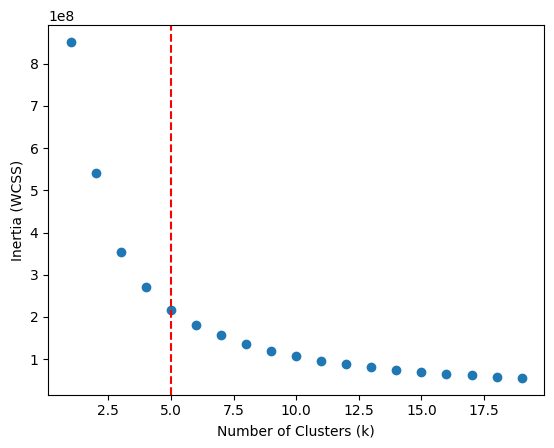

In [54]:
use_data = X_pca.copy()

# Assuming `X` is your data
inertia_values = []
# K = range(1, 60)
K = np.arange(1, 20, 1)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    cutoff = int(np.shape(use_data)[0]*0.8)
    X_train = np.vstack([use_data[:cutoff, 0], use_data[:cutoff, 1]]).T
    kmeans.fit(X_train)
    inertia_values.append(kmeans.inertia_)
    
kneedle = KneeLocator(K, inertia_values, curve="convex", direction="decreasing")
optimal_k = kneedle.knee
plt.axvline(x=optimal_k, color='r', linestyle='--', label=f'Elbow at k={optimal_k}')
# Plotting the inertia values
plt.scatter(K, inertia_values, marker='o')
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia (WCSS)')
plt.show()

## Clustering

In [ ]:
optimal_k = 3

In [ ]:
# Step 2: Perform KMeans Clustering
data_2d = embedding
# data_2d = X_pca
kmeans_trials = KMeans(n_clusters=optimal_k, random_state=2024)
kmeans_trials.fit(data_2d)

y_kmeans_trials = kmeans_trials.predict(data_2d)
plt.rcParams.update({'font.size': 16})

# Step 3: Plot the clusters
fig, ax = plt.subplots(figsize=(8, 6))
# Plot each cluster with a different color
palette = sns.color_palette("Set2", 7)  # List of 6 colors
palette = sns.color_palette("dark:salmon_r", 7, as_cmap=False)
# Map the cluster labels to colors
colors = [palette[i] for i in y_kmeans_trials]
scatter = ax.scatter(data_2d[:, 0], data_2d[:, 1], s=50, alpha=0.9, c=colors) # sns.color_palette("Set2", as_cmap=True) , cmap='Set2' c=y_kmeans_trials, 

# Plot the centroids
centroids = kmeans_trials.cluster_centers_
for c, cent in enumerate(centroids):
    dots = ax.text(centroids[c, 0], centroids[c, 1], str(c), c='black', alpha=1, fontsize=18, weight='bold')


# plt.title(epoch_to_analyse + " clusters")
plt.xlabel("UMAP 1")
plt.ylabel("UMAP 2")
# plt.title(epoch_to_analyse)

plt.show()